<a href="https://www.kaggle.com/code/rekibet/crop-production-india?scriptVersionId=148172400" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
import pandas as pd # Load and manipulate data

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import warnings

warnings.filterwarnings("ignore")

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:

df = pd.read_csv('/kaggle/input/crop-production-in-india/Crop_production.csv')

In [3]:
df.head()

,Unnamed: 0,State_Name,Crop_Type,Crop,N,P,K,pH,rainfall,temperature,Area_in_hectares,Production_in_tons,Yield_ton_per_hec
0,0,andhra pradesh,kharif,cotton,120,40,20,5.46,654.34,29.266667,7300.0,9400.0,1.287671
1,1,andhra pradesh,kharif,horsegram,20,60,20,6.18,654.34,29.266667,3300.0,1000.0,0.303030
2,2,andhra pradesh,kharif,jowar,80,40,40,5.42,654.34,29.266667,10100.0,10200.0,1.009901
3,3,andhra pradesh,kharif,maize,80,40,20,5.62,654.34,29.266667,2800.0,4900.0,1.750000
4,4,andhra pradesh,kharif,moong,20,40,20,5.68,654.34,29.266667,1300.0,500.0,0.384615


In [4]:
df.drop(["Unnamed: 0"],axis=1)

,State_Name,Crop_Type,Crop,N,P,K,pH,rainfall,temperature,Area_in_hectares,Production_in_tons,Yield_ton_per_hec
0,andhra pradesh,kharif,cotton,120,40,20,5.46,654.34,29.266667,7300.0,9400.0,1.287671
1,andhra pradesh,kharif,horsegram,20,60,20,6.18,654.34,29.266667,3300.0,1000.0,0.303030
2,andhra pradesh,kharif,jowar,80,40,40,5.42,654.34,29.266667,10100.0,10200.0,1.009901
3,andhra pradesh,kharif,maize,80,40,20,5.62,654.34,29.266667,2800.0,4900.0,1.750000
4,andhra pradesh,kharif,moong,20,40,20,5.68,654.34,29.266667,1300.0,500.0,0.384615
...,...,...,...,...,...,...,...,...,...,...,...,...
99844,west bengal,rabi,wheat,60,30,30,6.70,152.54,22.280000,2013.0,5152.0,2.559364
99845,west bengal,summer,maize,80,40,20,5.68,182.50,29.200000,258.0,391.0,1.515504
99846,west bengal,summer,rice,80,40,40,5.64,182.50,29.200000,105.0,281.0,2.676190
99847,west bengal,rabi,rice,80,40,40,5.42,152.54,22.280000,152676.0,261435.0,1.712352


In [5]:
df.size

1298037

In [6]:
df.shape

(99849, 13)

In [7]:
df.isnull().sum()

Unnamed: 0            0
State_Name            0
Crop_Type             0
Crop                  0
N                     0
P                     0
K                     0
pH                    0
rainfall              0
temperature           0
Area_in_hectares      0
Production_in_tons    0
Yield_ton_per_hec     0
dtype: int64

In [8]:
df["State_Name"].nunique()

33

In [9]:
crop_type = df["Crop_Type"].nunique()
crop_type

4

**Data Visualization**

**Analysing weather features only (Rainfall and temperature)**

In [10]:
Crop_rainfall_and_temp = (df.groupby(["Crop"])
                            [["rainfall", "temperature"]].sum()
                           )
Crop_rainfall_and_temp.head()

,rainfall,temperature
Crop,,
apple,2.653500e+03,82.963636
arecanut,2.056632e+06,28509.813091
ashgourd,2.476600e+04,774.327273
banana,3.130850e+06,64070.759879
barley,3.231518e+05,67899.542727


**Rainfall analysis**

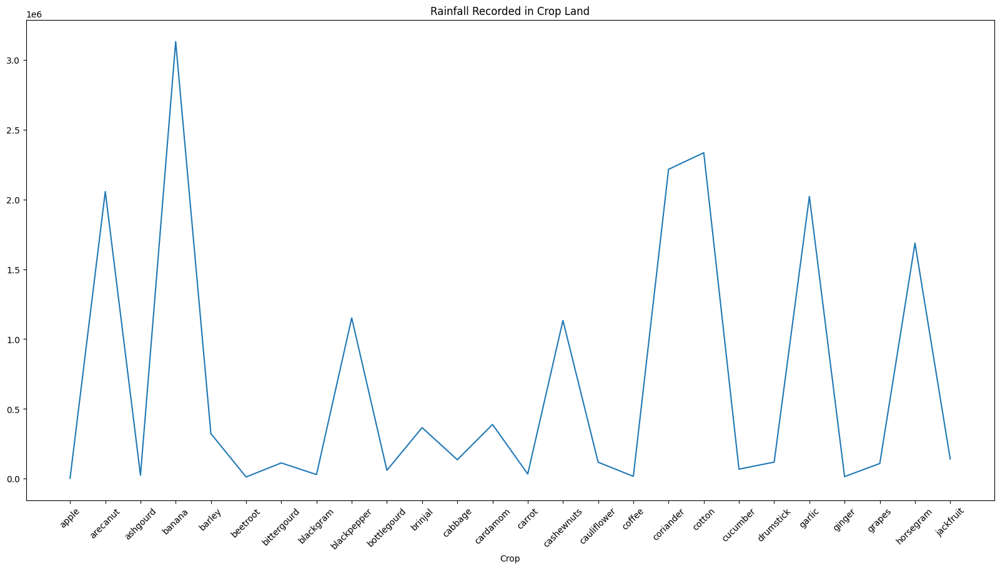

In [11]:
plt.figure(figsize=(20,10))
plt.plot(Crop_rainfall_and_temp["rainfall"].head(26))
plt.xlabel("Rainfall")
plt.xlabel("Crop")
plt.title("Rainfall Recorded in Crop Land")
plt.xticks(rotation=45);

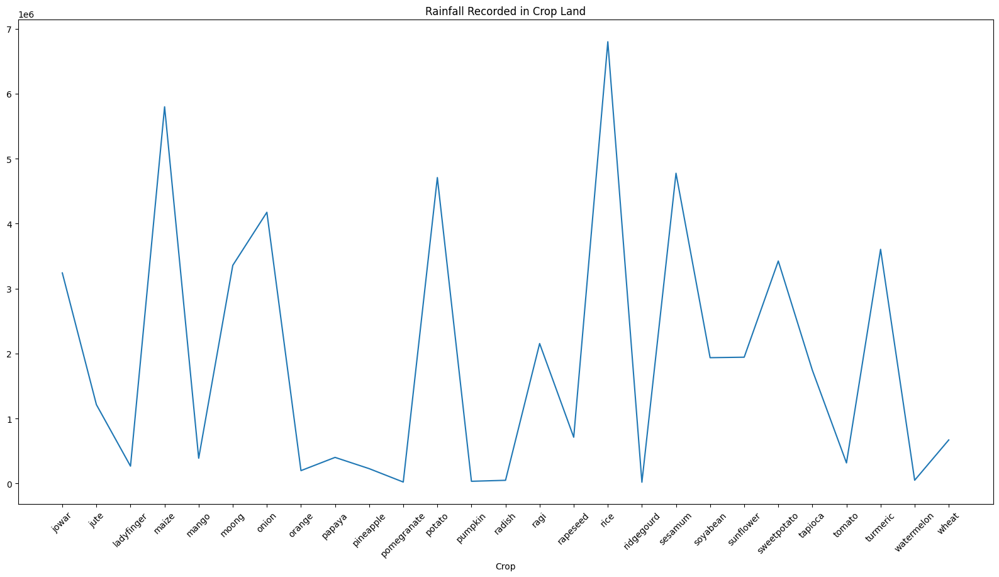

In [12]:
plt.figure(figsize=(20,10))
plt.plot(Crop_rainfall_and_temp["rainfall"].tail(27))
plt.xlabel("Rainfall")
plt.xlabel("Crop")
plt.title("Rainfall Recorded in Crop Land")
plt.xticks(rotation=45);

**Temperature analysis**

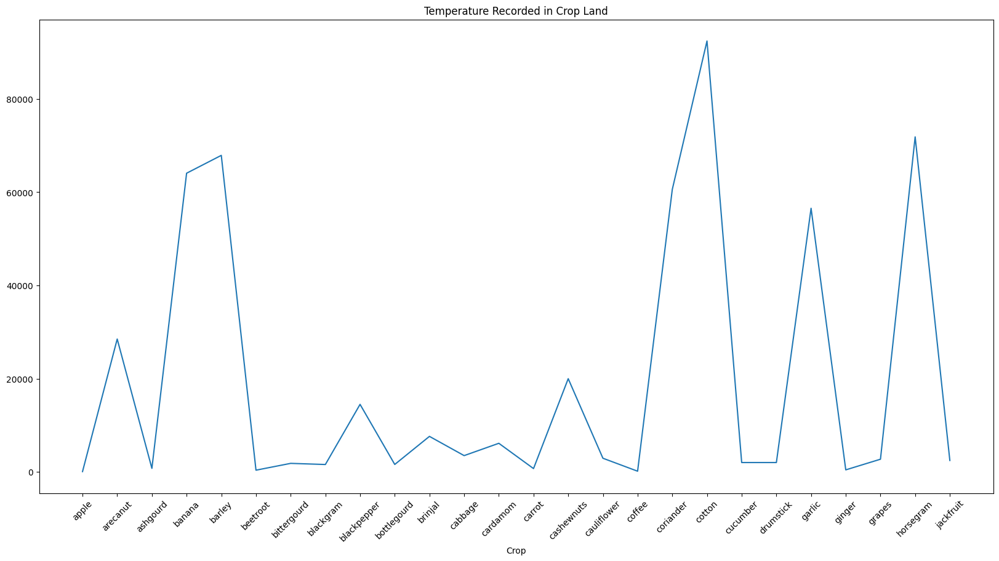

In [13]:
plt.figure(figsize=(20,10))
plt.plot(Crop_rainfall_and_temp["temperature"].head(26))
plt.xlabel("Temperature")
plt.xlabel("Crop")
plt.title("Temperature Recorded in Crop Land")
plt.xticks(rotation=45);

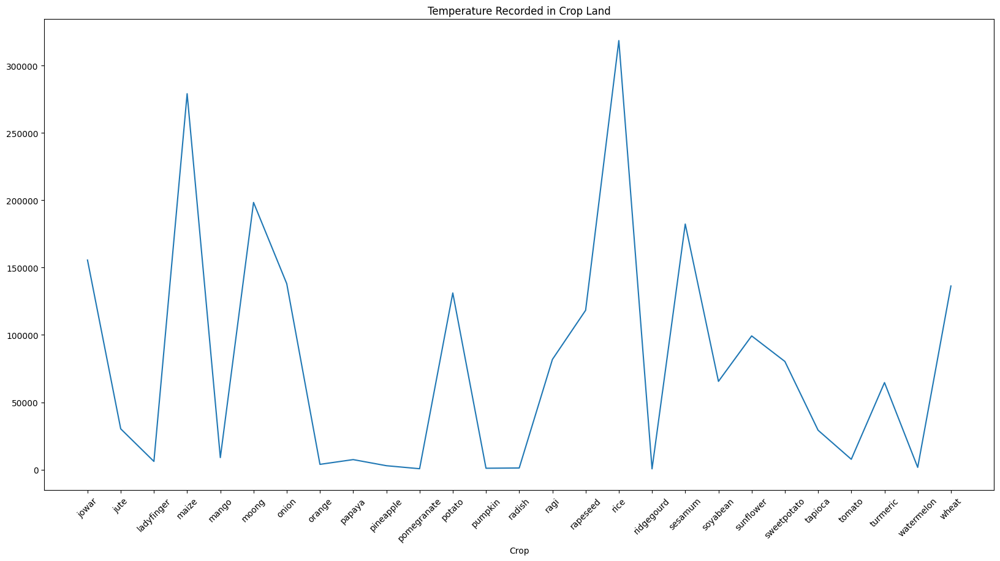

In [14]:
plt.figure(figsize=(20,10))
plt.plot(Crop_rainfall_and_temp["temperature"].tail(27))
plt.xlabel("Temperature")
plt.xlabel("Crop")
plt.title("Temperature Recorded in Crop Land")
plt.xticks(rotation=45);

**Crop, Area and Production**

In [15]:
"""
Crop and area its covers

"""
crop_unique = df["Crop"].nunique()

crop_unique

53

In [16]:
Crop_area_and_production = (df.groupby(["Crop"])
                            [["Area_in_hectares","Production_in_tons", "Yield_ton_per_hec"]].sum()
                           )
Crop_area_and_production

,Area_in_hectares,Production_in_tons,Yield_ton_per_hec
Crop,,,
apple,8.000000e+00,0.000000e+00,0.000000
arecanut,4.410533e+06,1.139215e+07,2130.523267
ashgourd,1.561000e+03,0.000000e+00,0.000000
banana,4.239542e+06,1.183549e+08,63134.076054
barley,8.990947e+06,1.872960e+07,5482.670438
beetroot,1.570000e+03,0.000000e+00,0.000000
bittergourd,5.940000e+03,2.970000e+02,39.914918
blackgram,6.483900e+04,4.165900e+04,39.534644
blackpepper,2.969130e+06,1.256464e+06,576.706070


In [17]:
# Confirm if the production of apple and other shown as Zero are actualy Zero
df[df["Crop"] == "apple"]

,Unnamed: 0,State_Name,Crop_Type,Crop,N,P,K,pH,rainfall,temperature,Area_in_hectares,Production_in_tons,Yield_ton_per_hec
37680,37680,tamil nadu,whole year,apple,20,125,200,6.48,884.5,27.654545,3.0,0.0,0.0
38056,38056,tamil nadu,whole year,apple,20,125,200,6.44,884.5,27.654545,1.0,0.0,0.0
46425,46425,tamil nadu,whole year,apple,20,125,200,6.46,884.5,27.654545,4.0,0.0,0.0


**Crops with reference to area**

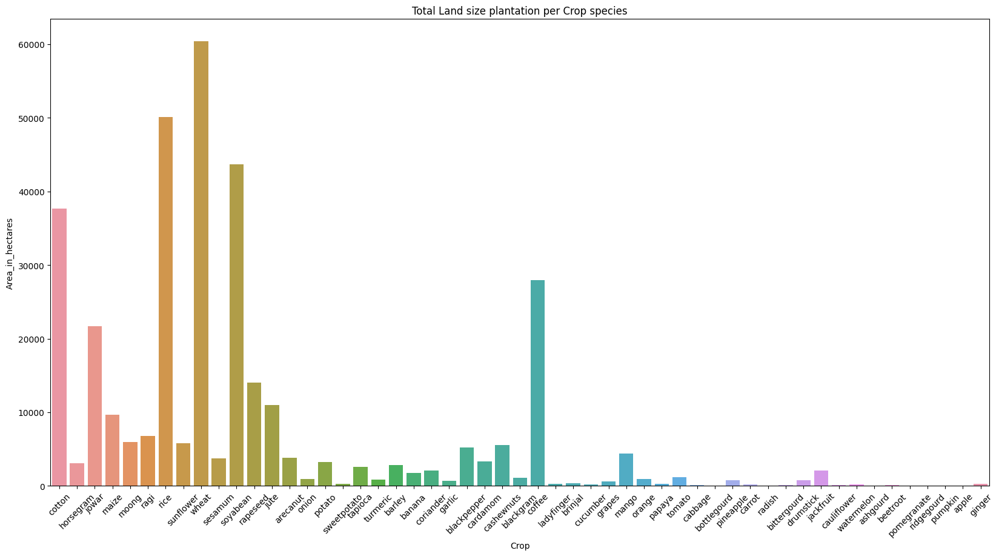

In [18]:
plt.figure(figsize=(20, 10))
sns.barplot(ci=False,
    data=df,
    x='Crop',
    y='Area_in_hectares'
)
plt.title("Total Land size plantation per Crop species")
plt.xticks(rotation=45);

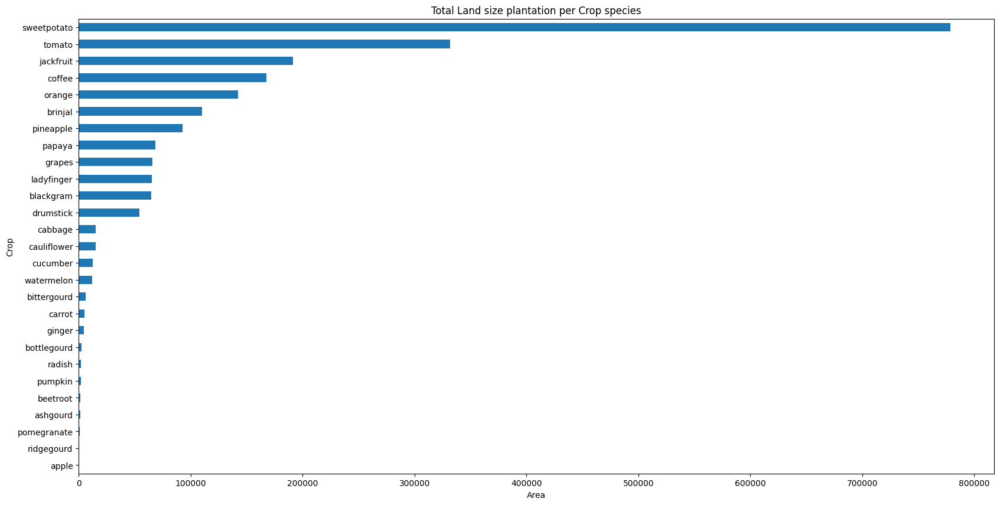

In [19]:
plt.figure(figsize=(20, 10))
Crop_area_and_production["Area_in_hectares"].sort_values(ascending=True).head(27).plot(
    kind = 'barh',
    xlabel = "Area",
    title = "Total Land size plantation per Crop species"
);

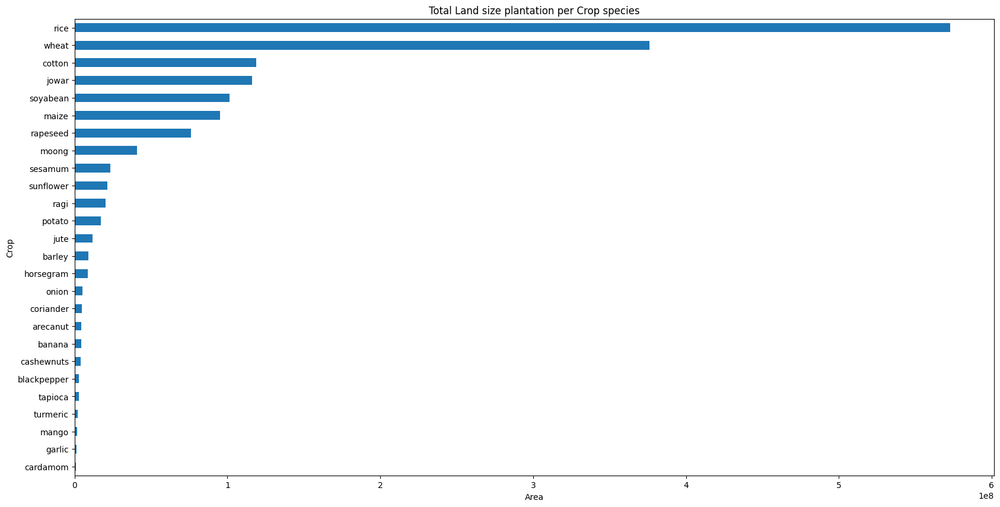

In [20]:
plt.figure(figsize=(20, 10))
Crop_area_and_production["Area_in_hectares"].sort_values(ascending=True).tail(26).plot(
    kind = 'barh',
    xlabel = "Area",
    title = "Total Land size plantation per Crop species"
);

**Crop Production total**

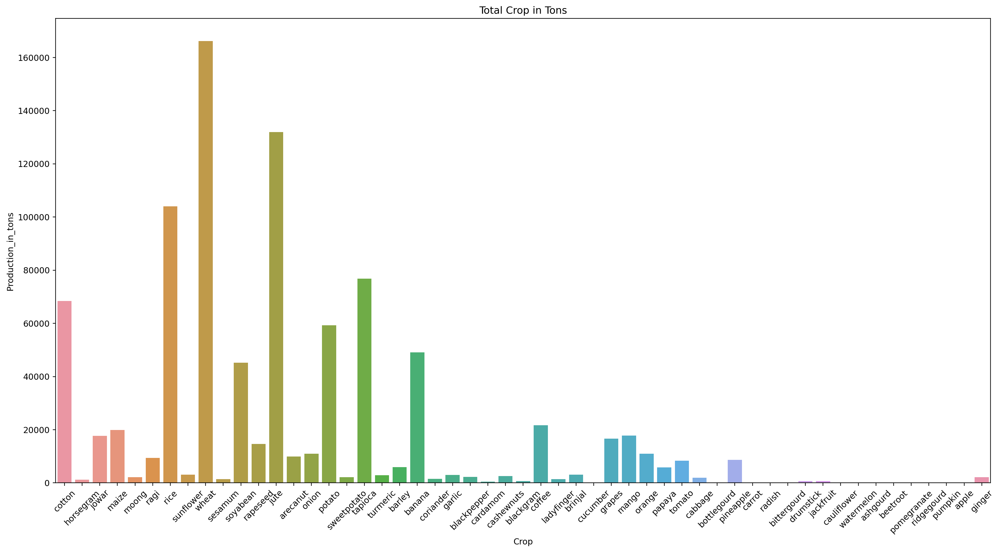

In [21]:
plt.figure(figsize=(20, 10), dpi=216)
sns.barplot(ci=False,
    data=df,
    x='Crop',
    y='Production_in_tons'
)
plt.title("Total Crop in Tons")
plt.xticks(rotation=45);

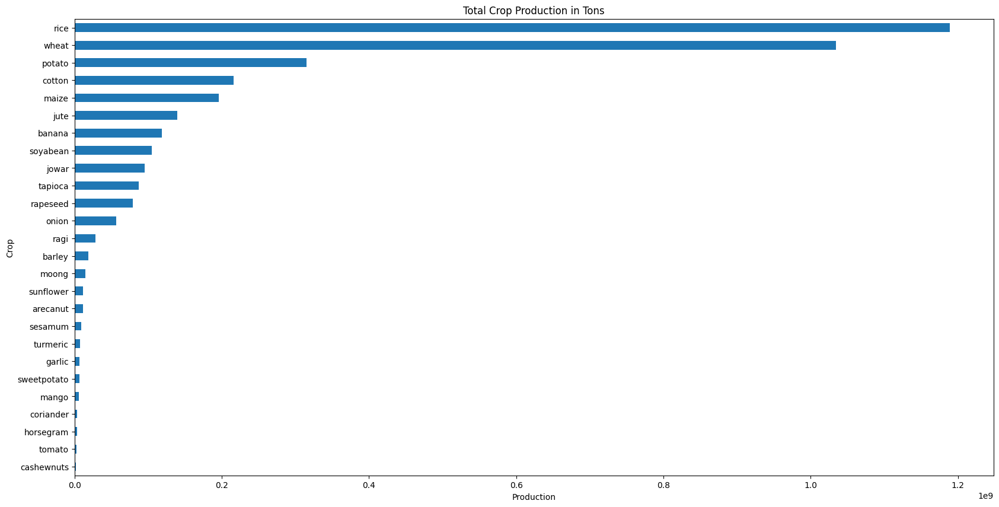

In [22]:
plt.figure(figsize=(20, 10))
Crop_area_and_production["Production_in_tons"].sort_values(ascending=True).tail(26).plot(
    kind = 'barh',
    xlabel = "Production",
    title = "Total Crop Production in Tons"
);

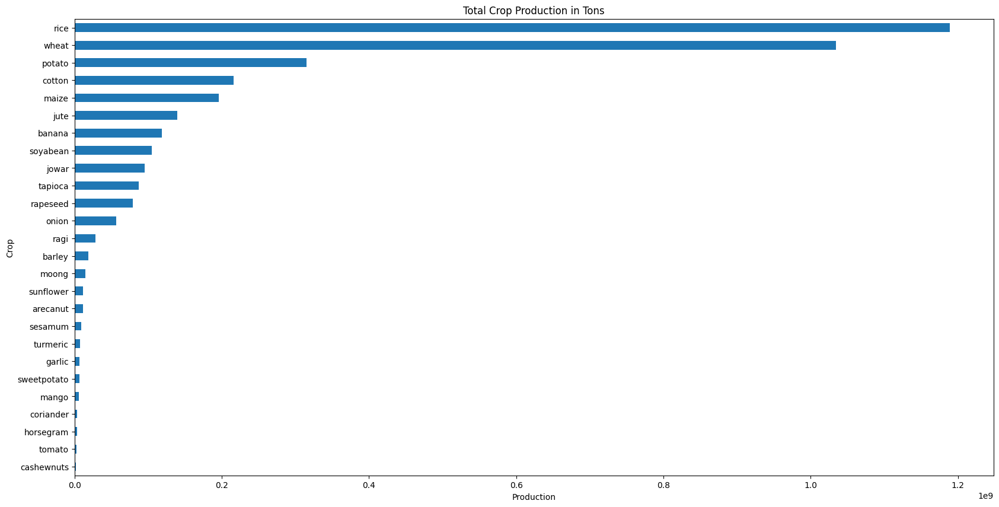

In [23]:
plt.figure(figsize=(20, 10))
Crop_area_and_production["Production_in_tons"].sort_values(ascending=True).tail(26).plot(
    kind = 'barh',
    xlabel = "Production",
    title = "Total Crop Production in Tons"
);

**State and weather**

In [24]:
state_weather_elements = (df.groupby(["State_Name"])
                            [["rainfall", "temperature"]].sum()
                           )
state_weather_elements.head()

,rainfall,temperature
State_Name,,
andaman and nicobar islands,306188.34,3179.490909
andhra pradesh,2367553.74,104941.513939
arunachal pradesh,1544962.24,6797.400000
assam,7734428.36,132665.269697
bihar,4743065.28,254460.489576


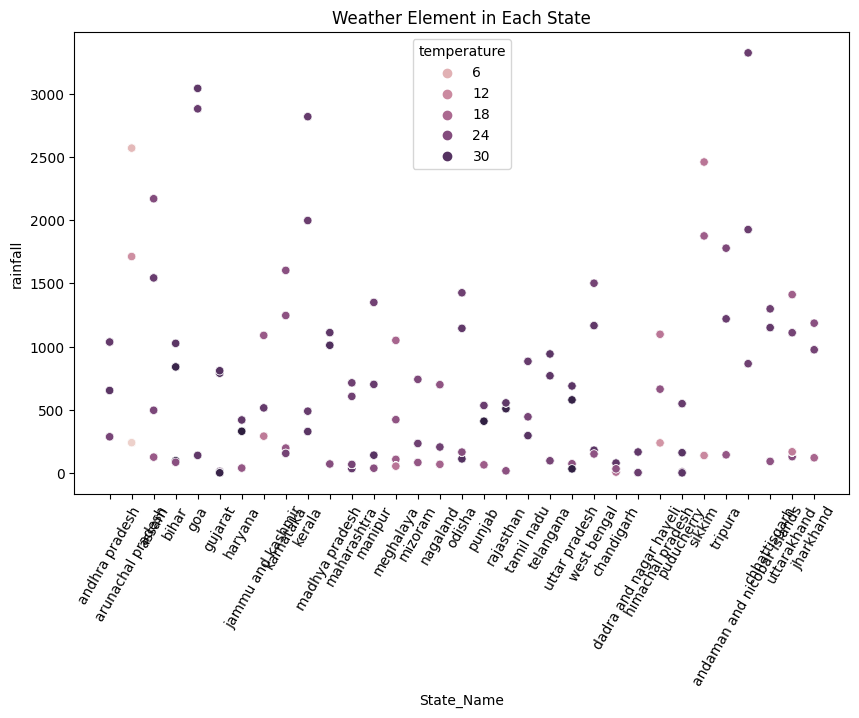

In [25]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['State_Name'], 
                y=df['rainfall'],
                hue=df['temperature'])
plt.title("Weather Element in Each State")
plt.xticks(rotation=60);

**State and Production in Tons**

In [26]:
state_area_plantation_production = (df.groupby(["State_Name"])
                            [["Area_in_hectares", "Production_in_tons"]].sum()
                           )
state_area_plantation_production .head()

,Area_in_hectares,Production_in_tons
State_Name,,
andaman and nicobar islands,136418.65,3.844167e+05
andhra pradesh,56454744.00,1.584045e+08
arunachal pradesh,2385509.00,3.271814e+06
assam,43786886.00,8.285917e+07
bihar,90856659.00,1.788725e+08


In [27]:
fig = px.histogram(
    df,
    x="State_Name",
    y="Area_in_hectares",
    color="State_Name",
    marginal="rug",
    hover_data=df.columns
)
fig.show()

**State and Crop Produce**

In [28]:
fig = px.histogram(
    df,
    x="State_Name",
    y="Production_in_tons",
    color="State_Name",
    marginal="rug",
    hover_data=df.columns
)
fig.show()